In [39]:
#Imports
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import random

import cv2
import glob
from skimage import feature

from skimage.metrics import structural_similarity as ssim
from sewar.full_ref import rmse, psnr, uqi

# Import helper functions from utils.py
import utils 


def add_gaussian_noise(image, mean=0, std=500):
    """
    Adds Gaussian noise to Sentinel multi-band image (e.g., in 0–10000 range).

    Parameters:
        image (np.ndarray): Original image (H, W, C)
        mean (float): Mean of Gaussian noise
        std (float): Standard deviation of Gaussian noise

    Returns:
        np.ndarray: Noisy image clipped to valid range
    """
    noise = np.random.normal(mean, std, image.shape).astype(np.float32)
    noisy_image = np.clip(image + noise, 0, 30000)  # Sentinel max cap
    return noisy_image.astype(np.uint16)

    
#Save path 
save_path = r"E:\SNU Chennai\projects\IVP\edge-detection-metrics\Evaluation metrics"

# Global variables
channels = ['Coastal \nAerosol','Blue','Green',
                 'Red','Red Edge 1','Red Edge 2',
                'Red Edge 3','NIR','Red Edge 4',
                 'Water \nVapour','SWIR 1','SWIR 2']

thresholds = [[50,100],[50,150],[100,200],[100,300],[200,400],[200,600]] 

In [40]:
# Reload utils
import importlib
importlib.reload(utils)

<module 'utils' from 'e:\\SNU Chennai\\projects\\IVP\\edge-detection-metrics\\src\\utils.py'>

In [41]:
test_path = glob.glob(r"E:\SNU Chennai\projects\IVP\edge-detection-metrics\SWED\SWED\test\images\*")
print(test_path[0])
print(len(test_path))

# Initialise data processing class
processor = utils.data_processor()

def get_input(paths, add_noise=False):
    input = []
    rgb = []
    labels = []

    for path in paths:
        try:
            img, rgb_img, label = processor.load_test(path)
            if add_noise:
                img = add_gaussian_noise(img)  # Add noise here
            input.append(img)
            labels.append(label)
            rgb.append(rgb_img)
        except:
            print("Error with image: ", path)

    canny_input = [np.uint8(img * 255) for img in labels]
    edge_reference = [np.uint8(cv2.Canny(img, threshold1=100, threshold2=200)) for img in canny_input]

    return input, rgb, labels, edge_reference

input, rgb, labels, edge_reference = get_input(test_path, add_noise=True)


E:\SNU Chennai\projects\IVP\edge-detection-metrics\SWED\SWED\test\images\S2A_MSIL2A_20190312T031541_N0211_R118_T48QYJ_20190312T083550_image_0_0.tif
98


96
0 255


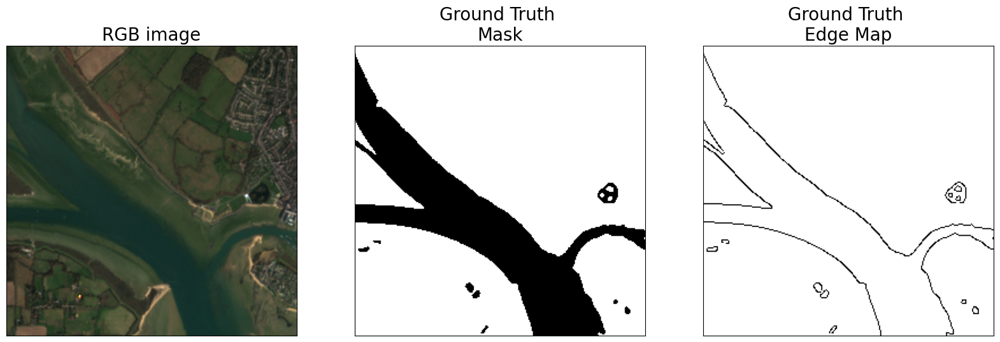

In [42]:
# Sense check edge references
rint = np.random.randint(0,len(edge_reference))
print(rint)
fig, ax = plt.subplots(1,3, figsize=(20,20))
fig.set_facecolor('white')

ax[0].imshow(rgb[rint])
ax[0].set_title('RGB image',size=20)
ax[1].imshow(1-labels[rint] ,  cmap='gray')
ax[1].set_title('Ground Truth \nMask',size=20)
ax[2].imshow(255-edge_reference[rint], cmap='gray')
ax[2].set_title('Ground Truth \nEdge Map',size=20)

for a in ax:
    a.set_xticks([])
    a.set_yticks([])

print(np.min(edge_reference[rint]) ,np.max(edge_reference[rint]))

plt.savefig(save_path + '\\Figures\\dataset_example.png', dpi=300, bbox_inches='tight')

In [43]:
# Apply canny edge detection with different intensity thresholds
def get_canny(input):
        canny_input = input.copy()
        canny = {}

        for threshold in thresholds:
                t1 = threshold[0]
                t2 = threshold[1]
                canny[str(threshold)] = [processor.canny_ed(img,threshold1=t1,threshold2=t2) for img in canny_input]

                print(threshold, len(canny[str(threshold)]),'done')

        return canny

canny = get_canny(input)

[50, 100] 98 done
[50, 150] 98 done
[100, 200] 98 done
[100, 300] 98 done
[200, 400] 98 done
[200, 600] 98 done


In [44]:
# Evaluate canny edge detection with rmse, psnr, uqi, ssim and fom and confusion matrix measures
rows = []

for threshold in thresholds:
    canny_output = canny[str(threshold)]

    for i, output in enumerate(canny_output):
        ref_img = edge_reference[i]
        #ID = "IMG#{}".format(i)
        ID = i
        for j in range(len(channels)):
                
            img = output[:,:,j]

            # Evaluation metrics
            rmse_ = rmse(ref_img,img)
            psnr_ = psnr(ref_img,img)
            uqi_ = uqi(ref_img,img)
            ssim_ = ssim(ref_img,img,multichannel=True)
            fom_ = processor.fom(ref_img,img)
            tp_,fp_,tn_,fn_,tpr_,fpr_,tnr_,fnr_,fp_fn_ratio_ = processor.get_rates(ref_img,img)

            # detect edges as a percentage of reference edges
            pde_ = np.count_nonzero(img)/np.count_nonzero(ref_img)
            
            row = [ID,tuple(threshold),j+ 1,rmse_,psnr_,uqi_,ssim_,fom_,tp_,fp_,tn_,fn_,tpr_,fpr_,tnr_,fnr_,fp_fn_ratio_,pde_]
            rows.append(row)

    print(threshold,'done')
    
df_metrics = pd.DataFrame(rows,columns = ['ID',"thresholds","band","rmse","psnr","uqi","ssim","fom","tp","fp","tn","fn","tpr","fpr","tnr","fnr","fp_fn_ratio","pde"])
df_metrics.to_csv(save_path+"\\canny_evaluation_metrics.csv")
df_metrics.head()

[50, 100] done
[50, 150] done
[100, 200] done
[100, 300] done
[200, 400] done
[200, 600] done


,ID,thresholds,band,rmse,psnr,uqi,ssim,fom,tp,fp,tn,fn,tpr,fpr,tnr,fnr,fp_fn_ratio,pde
0,0,"(50, 100)",1,156.915594,4.217482,0.037961,0.002702,0.229188,948,23334,39772,1482,0.390123,0.369759,0.630241,0.609877,15.744939,9.992593
1,0,"(50, 100)",2,157.095701,4.207518,0.036206,0.000368,0.226895,891,23334,39772,1539,0.366667,0.369759,0.630241,0.633333,15.161793,9.969136
2,0,"(50, 100)",3,157.196723,4.201934,0.036066,0.000189,0.227936,897,23372,39734,1533,0.369136,0.370361,0.629639,0.630864,15.245923,9.987243
3,0,"(50, 100)",4,156.918756,4.217306,0.037343,0.002061,0.229940,946,23333,39773,1484,0.389300,0.369743,0.630257,0.610700,15.723046,9.991358
4,0,"(50, 100)",5,157.206190,4.201411,0.036259,0.000261,0.228285,905,23383,39723,1525,0.372428,0.370535,0.629465,0.627572,15.333115,9.995062


In [45]:
df_metrics = pd.read_csv(save_path+"\\canny_evaluation_metrics.csv")
df_metrics['fp_fn'] = df_metrics['fp'] + df_metrics['fn']

# Initialise visualisation class
viz = utils.data_visualizer(df_metrics,canny,edge_reference,rgb,thresholds,channels)

In [46]:
df_metrics.head()

,Unnamed: 0,ID,thresholds,band,rmse,psnr,uqi,ssim,fom,tp,fp,tn,fn,tpr,fpr,tnr,fnr,fp_fn_ratio,pde,fp_fn
0,0,0,"(50, 100)",1,156.915594,4.217482,0.037961,0.002702,0.229188,948,23334,39772,1482,0.390123,0.369759,0.630241,0.609877,15.744939,9.992593,24816
1,1,0,"(50, 100)",2,157.095701,4.207518,0.036206,0.000368,0.226895,891,23334,39772,1539,0.366667,0.369759,0.630241,0.633333,15.161793,9.969136,24873
2,2,0,"(50, 100)",3,157.196723,4.201934,0.036066,0.000189,0.227936,897,23372,39734,1533,0.369136,0.370361,0.629639,0.630864,15.245923,9.987243,24905
3,3,0,"(50, 100)",4,156.918756,4.217306,0.037343,0.002061,0.229940,946,23333,39773,1484,0.389300,0.369743,0.630257,0.610700,15.723046,9.991358,24817
4,4,0,"(50, 100)",5,157.206190,4.201411,0.036259,0.000261,0.228285,905,23383,39723,1525,0.372428,0.370535,0.629465,0.627572,15.333115,9.995062,24908


In [47]:
#Update visualisation class 
# The following test images are removed due to labelling errors: 18, 41, 66
df_metrics_2 = df_metrics.copy()
df_metrics_2 = df_metrics_2.drop(df_metrics_2[df_metrics_2['ID'] == 18].index)
df_metrics_2 = df_metrics_2.drop(df_metrics_2[df_metrics_2['ID'] == 41].index)
df_metrics_2 = df_metrics_2.drop(df_metrics_2[df_metrics_2['ID'] == 66].index)

df_metrics_2['fp_fn'] = df_metrics_2['fp'] + df_metrics_2['fn']


test_paths_2 = test_path.copy()
path1 = test_paths_2.pop(18)
path2 = test_paths_2.pop(41-1)
path3 = test_paths_2.pop(66-2)
print(path1)
print(path2)
print(path3)

input_2, rgb_2, labels_2, edge_reference_2 = get_input(test_paths_2)

canny_2 = get_canny(input_2)

viz_2 = utils.data_visualizer(df_metrics_2,canny_2,edge_reference_2,rgb_2,thresholds,channels)


E:\SNU Chennai\projects\IVP\edge-detection-metrics\SWED\SWED\test\images\S2A_MSIL2A_20190725T072621_N0213_R049_T37MER_20190725T114710_image_0_0.tif
E:\SNU Chennai\projects\IVP\edge-detection-metrics\SWED\SWED\test\images\S2A_MSIL2A_20191003T022551_N0213_R046_T49MGM_20191003T062924_image_0_3.tif
E:\SNU Chennai\projects\IVP\edge-detection-metrics\SWED\SWED\test\images\S2A_MSIL2A_20191226T071311_N0213_R106_T39RWH_20191226T094655_image_0_1.tif
[50, 100] 95 done
[50, 150] 95 done
[100, 200] 95 done
[100, 300] 95 done
[200, 400] 95 done
[200, 600] 95 done


In [48]:
print("fp_fn" in df_metrics_2.columns)
print(df_metrics_2[["fp", "fn", "fp_fn"]].head())


True
      fp    fn  fp_fn
0  23334  1482  24816
1  23334  1539  24873
2  23372  1533  24905
3  23333  1484  24817
4  23383  1525  24908


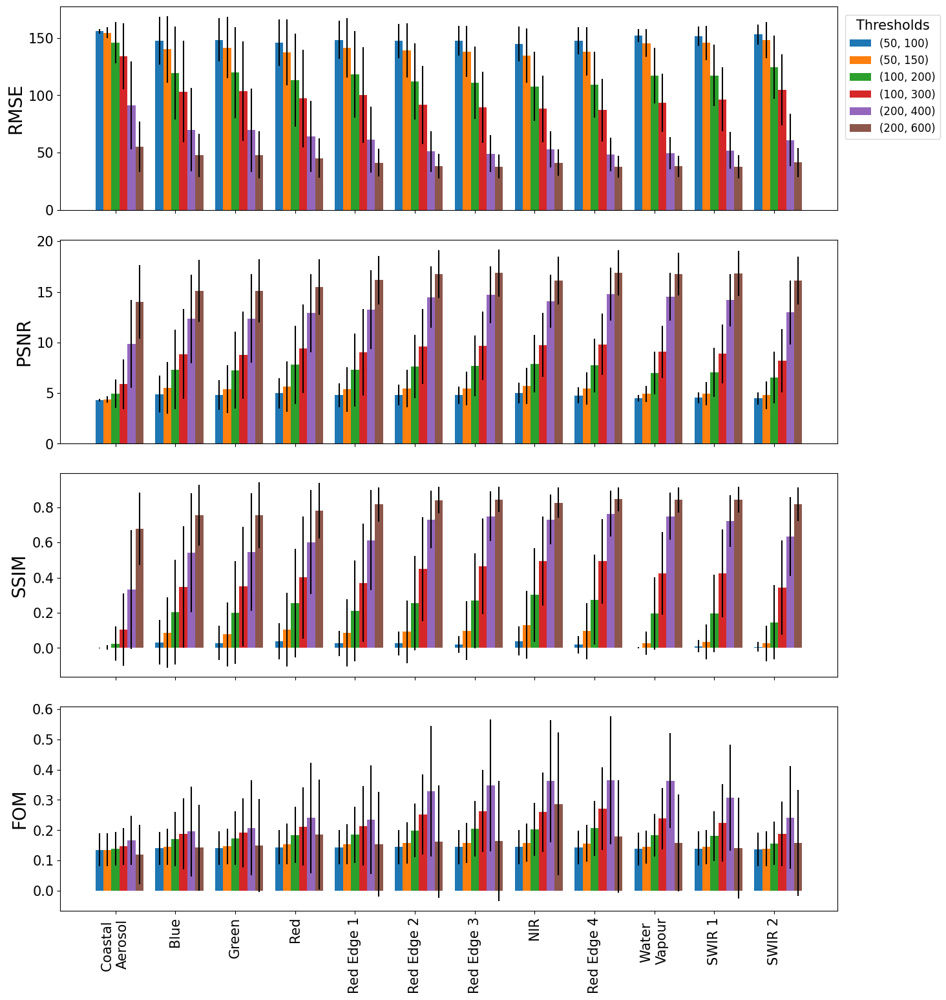

In [49]:
viz_2.plot_combined_metric_trends(['rmse','psnr','ssim','fom'],save_path=save_path+"\\Figures\\all_metrics.png")

In [50]:
# NIR table 
df_metrics_nir = df_metrics_2[df_metrics_2['band']==7]

df_mean = df_metrics_nir[['thresholds', 'rmse','psnr','ssim','fom']].groupby('thresholds').mean().reset_index()
df_mean['threshold 1'] = df_mean['thresholds'].apply(lambda x: int(x.split(',')[0][1:]))
df_mean['threshold 2'] = df_mean['thresholds'].apply(lambda x: int(x.split(',')[1][:-1]))

df_mean = df_mean.sort_values(by=['threshold 1','threshold 2'])[['threshold 1','threshold 2','rmse','psnr','ssim','fom']]
df_mean.columns = ['Threshold 1','Threshold 2','RMSE','PSNR','SSIM','FOM']
df_mean = df_mean.round(2)

df_mean.to_clipboard(index=False)

df_mean.head()

,Threshold 1,Threshold 2,RMSE,PSNR,SSIM,FOM
4,50,100,147.59,4.79,0.02,0.14
5,50,150,138.21,5.46,0.10,0.16
0,100,200,110.87,7.68,0.27,0.20
1,100,300,89.59,9.68,0.47,0.26
2,200,400,49.26,14.73,0.75,0.35


In [51]:
# counts of best thresholds
best_threshold_count = pd.DataFrame(thresholds,columns=['threshold1','threshold2'])

for metric in ['rmse','psnr','ssim','fom']:

    df = df_metrics_2[['ID','thresholds',metric]]

    if metric == 'rmse':
        best_thresholds = df.loc[df.groupby('ID')[metric].idxmin()]
    else:
        best_thresholds = df.loc[df.groupby('ID')[metric].idxmax()]
    count = []
    print(f"\nBest thresholds for {metric}:")
    print(best_thresholds.head())  # Debugging
    for threshold in thresholds:
        df = best_thresholds[best_thresholds['thresholds'].astype(str) == str(tuple(threshold))]
        count.append(len(df))
        # Debugging: Print how many times each threshold appears
        print(f"Threshold {threshold}: {len(df)} occurrences")

    best_threshold_count[metric] = count

best_threshold_count.columns = ['Threshold 1','Threshold 2','RMSE','PSNR','SSIM','FOM']

best_threshold_count.to_clipboard(index=False)
best_threshold_count


Best thresholds for rmse:
      ID  thresholds       rmse
5891   0  (200, 600)  49.102471
5896   1  (200, 600)  33.867188
5915   2  (200, 600)  35.831695
5922   3  (200, 600)  33.808543
5936   4  (200, 600)  51.393032
Threshold [50, 100]: 0 occurrences
Threshold [50, 150]: 0 occurrences
Threshold [100, 200]: 0 occurrences
Threshold [100, 300]: 0 occurrences
Threshold [200, 400]: 2 occurrences
Threshold [200, 600]: 93 occurrences

Best thresholds for psnr:
      ID  thresholds       psnr
5891   0  (200, 600)  14.308737
5896   1  (200, 600)  17.535221
5915   2  (200, 600)  17.045457
5922   3  (200, 600)  17.550275
5936   4  (200, 600)  13.912719
Threshold [50, 100]: 0 occurrences
Threshold [50, 150]: 0 occurrences
Threshold [100, 200]: 0 occurrences
Threshold [100, 300]: 0 occurrences
Threshold [200, 400]: 2 occurrences
Threshold [200, 600]: 93 occurrences

Best thresholds for ssim:
      ID  thresholds      ssim
5891   0  (200, 600)  0.755048
5896   1  (200, 600)  0.868417
5915   2  (2

,Threshold 1,Threshold 2,RMSE,PSNR,SSIM,FOM
0,50,100,0,0,0,0
1,50,150,0,0,0,2
2,100,200,0,0,0,0
3,100,300,0,0,0,10
4,200,400,2,2,2,56
5,200,600,93,93,93,27


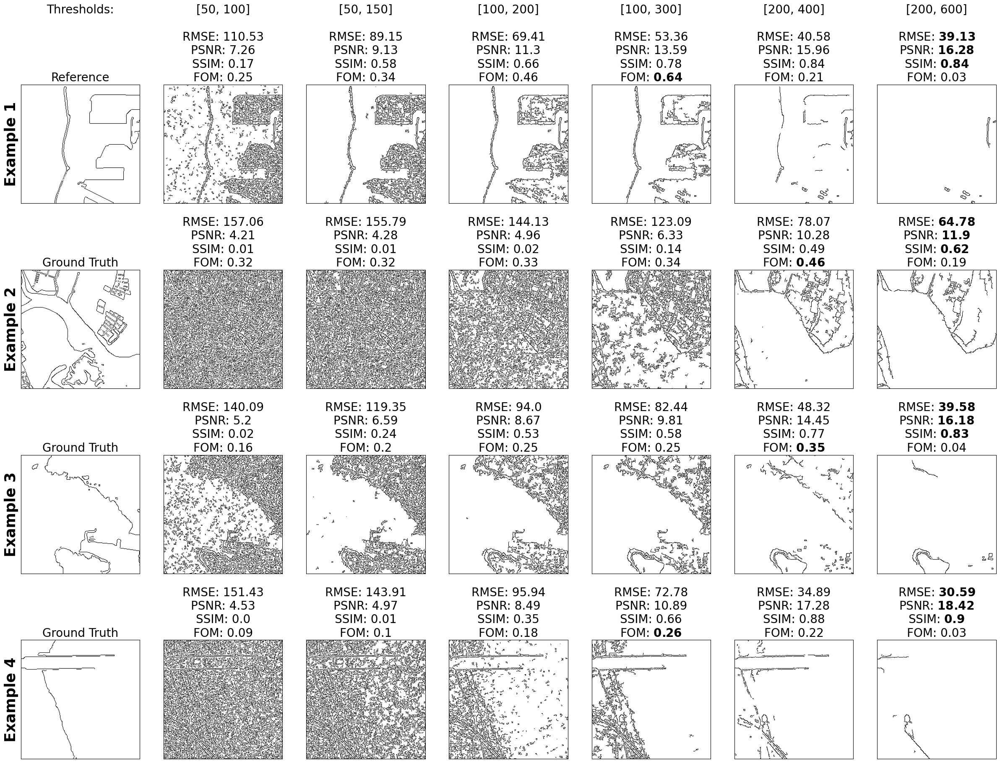

In [52]:
# Examples of results where FOM identifies the best threshold
import ast

# Convert thresholds to tuples if they are stored as strings
df_metrics_2["thresholds"] = df_metrics_2["thresholds"].apply(lambda x: tuple(ast.literal_eval(x)) if isinstance(x, str) else x)

IDs = [74,40,2,68]
viz.example_plots(IDs,save_path=save_path+"\\Figures\\good_examples.png")

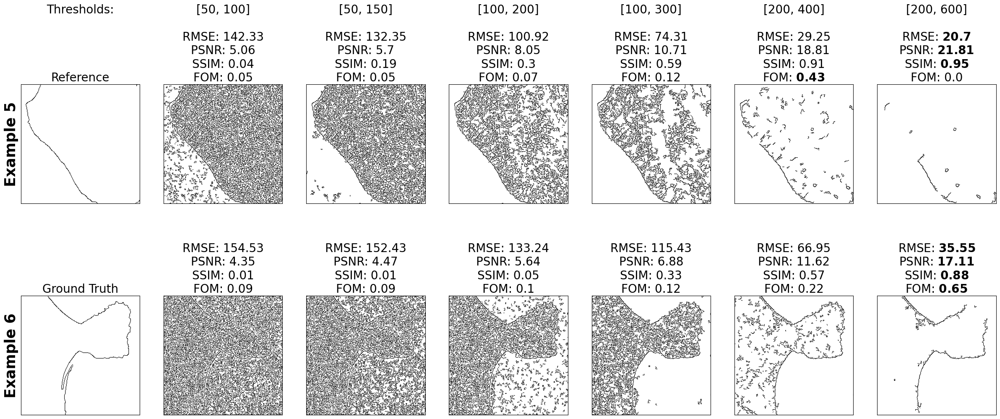

In [53]:
# Examples of results where FOM does not identify the best threshold
IDs = [15,32]
viz.example_plots(IDs,ex_diff=4,save_path=save_path+"\\Figures\\bad_examples.png")

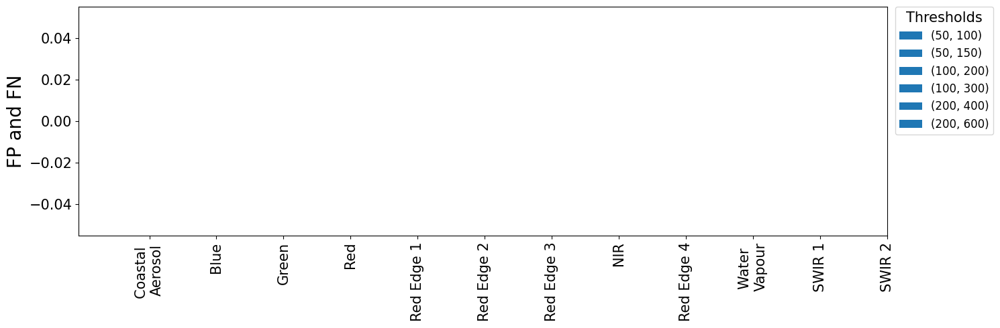

In [54]:
viz_2.plot_metric_trends('fp_fn', ylabel="FP and FN", save_path=save_path+"\\Figures\\fp_fn_sum.png")


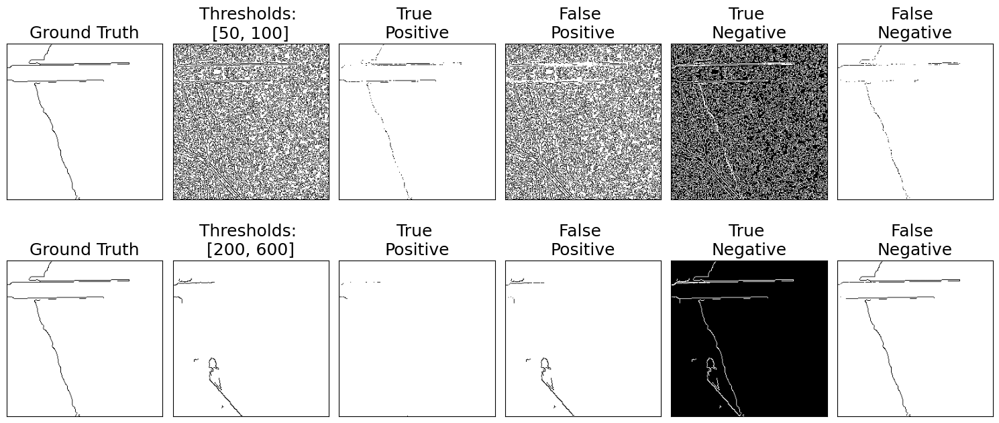

In [55]:
# Plot of confusion matrix metrics for different thresholds
rint = random.randint(0,len(edge_reference))
rint = 68 
band = 7 
threshold = [100,300]

fig, axs = plt.subplots(2,6, figsize=(15,7))
fig.set_facecolor('white')

for i, threshold in enumerate([[50,100],[200,600]]):
    reference = edge_reference[rint]*1.0
    reference = np.array(reference)

    detected =  canny[str(threshold)][rint][:,:,band]*1.0
    detected = np.array(detected)

    # True Positive
    TP = reference - (255-detected)
    TP[TP<0] = 0

    # False Positive
    FP = detected - TP

    # False negatives
    N = 255 - detected
    FN = N - (255-reference)

    # True Negative
    TN  = (255-reference) -detected
    TN[TN<0] = 0

    # False Negative
    FN = (255-detected) - (255-reference)
    FN[FN<0] = 0

    axs[i,0].imshow(255-reference,cmap="gray")
    axs[i,0].set_title("Ground Truth",size=18)

    axs[i,1].imshow(255-detected,cmap="gray")
    axs[i,1].set_title("Thresholds: \n{}".format(threshold),size=18)

    axs[i,2].imshow(255-TP,cmap="gray")
    axs[i,2].set_title("True \nPositive",size=18)

    axs[i,3].imshow(255-FP,cmap="gray")
    axs[i,3].set_title("False \nPositive",size=18)

    axs[i,4].imshow(255-TN,cmap="gray")
    axs[i,4].set_title("True \nNegative",size=18)

    axs[i,5].imshow(255-FN,cmap="gray")
    axs[i,5].set_title("False \nNegative",size=18)

for ax in axs.flat:
    ax.set_xticks([])
    ax.set_yticks([])

plt.tight_layout()
plt.savefig(save_path+"\\Figures\\TP_FP_example.png",dpi=300)

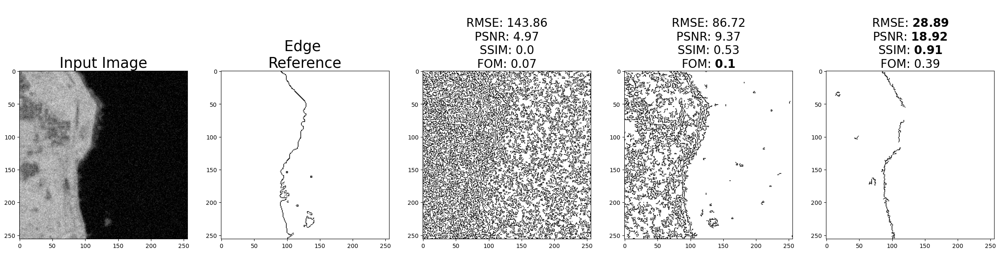

In [56]:
import importlib
importlib.reload(utils)  # Ensure latest version of utils is used

fig, axs = plt.subplots(1, 5, figsize=(30, 20))
fig.set_facecolor('white')

rint = 67  # Select image index

thresholds = [[50,100],[100,200],[200,400]]
band = 10 

img_input = input[rint].copy()

axs[0].imshow(img_input[:,:,band], cmap="gray")
axs[0].set_title("Input Image", size=25)

ref_img = edge_reference[rint]
axs[1].imshow(255 - ref_img, cmap="gray")
axs[1].set_title("Edge \nReference", size=25)

# Ensure we use the processor instance to call canny_ed
processor = utils.data_processor()  

for i, threshold in enumerate(thresholds):
    t1, t2 = threshold
    canny = processor.canny_ed(img_input, threshold1=t1, threshold2=t2)  # Call with processor instance
    img = canny[:,:,band]
    
    axs[i+2].imshow(255 - img, cmap="gray")
    
    rmse_ = round(rmse(ref_img, img), 2)
    psnr_ = round(psnr(ref_img, img), 2)
    ssim_ = round(ssim(ref_img, img, multichannel=True), 2)
    fom_ = round(processor.fom(ref_img, img), 2)

    if i == 0:
        axs[i+2].set_title("\nRMSE: {}\nPSNR: {}\nSSIM: {}\nFOM: {}".format(rmse_, psnr_, ssim_, fom_), size=20)
    elif i == 1:
        axs[i+2].set_title("\nRMSE: {}\nPSNR: {}\nSSIM: {}\nFOM: ".format(rmse_, psnr_, ssim_) + r"$\bf{" + str(fom_) + "}$", size=20)
    else:
        axs[i+2].set_title("\nRMSE: " + r"$\bf{" + str(rmse_) + "}$" + 
                           "\nPSNR: " + r"$\bf{" + str(psnr_) + "}$" +
                           "\nSSIM: " + r"$\bf{" + str(ssim_) + "}$" +
                           "\nFOM: " + str(fom_), size=20)

plt.show()


In [57]:
#Get image names for visual analysis
x = [path.split("/")[-1] for path in test_path]
df = pd.DataFrame({"ID":x})
df.to_clipboard(index=False)

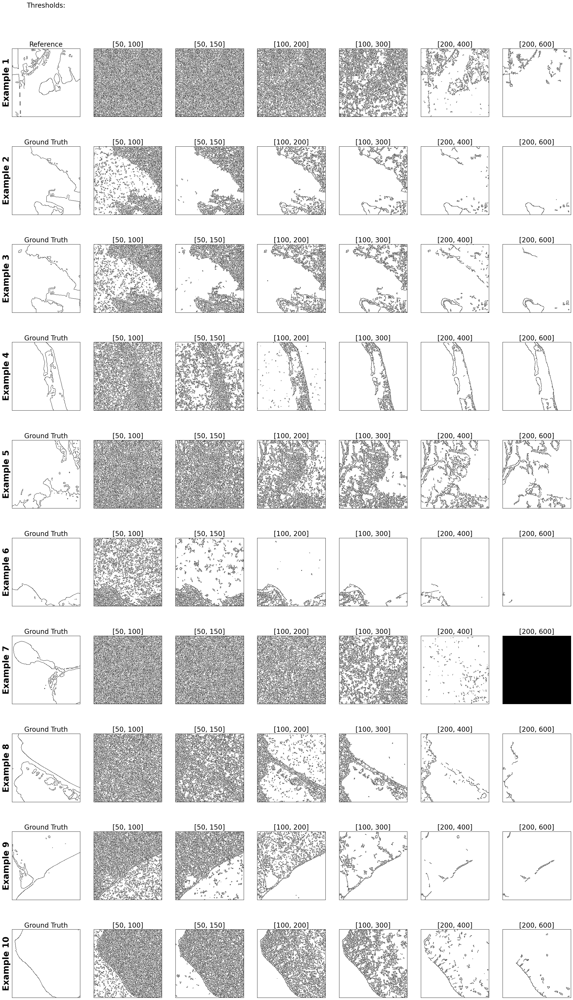

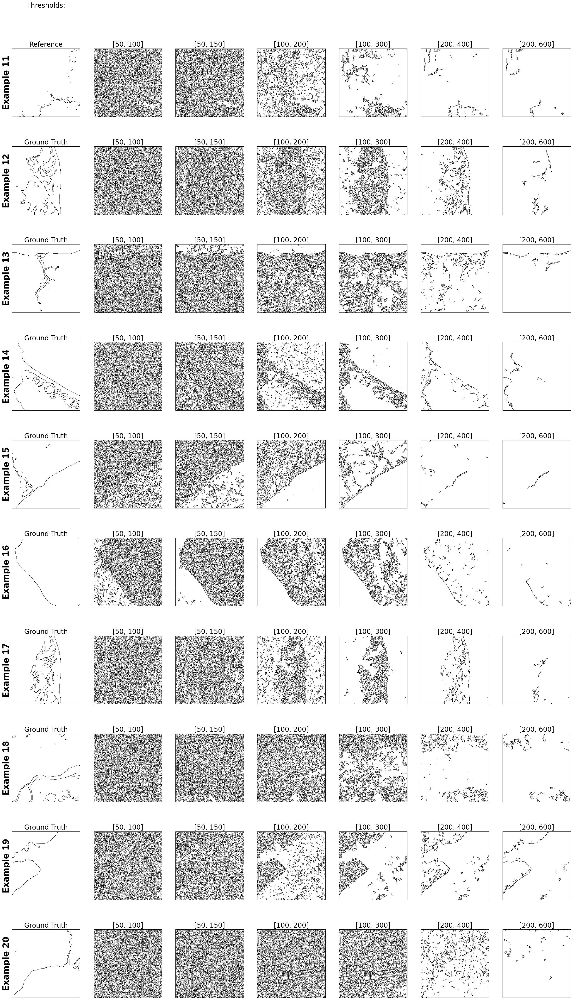

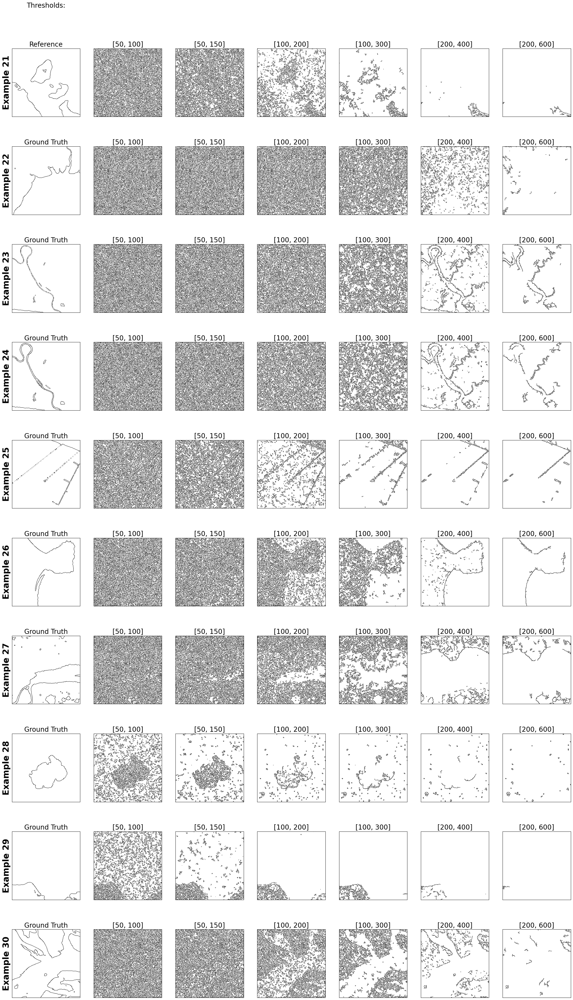

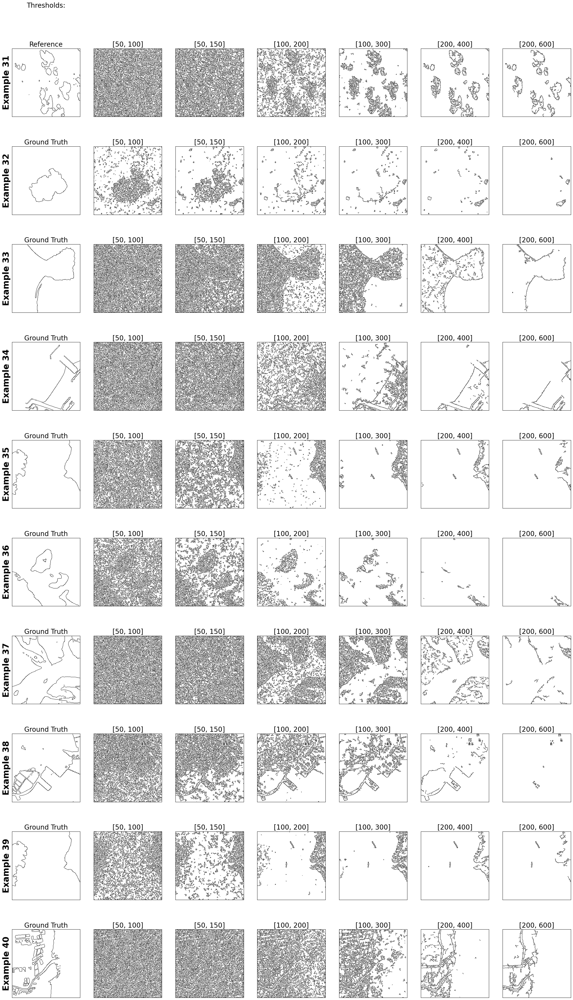

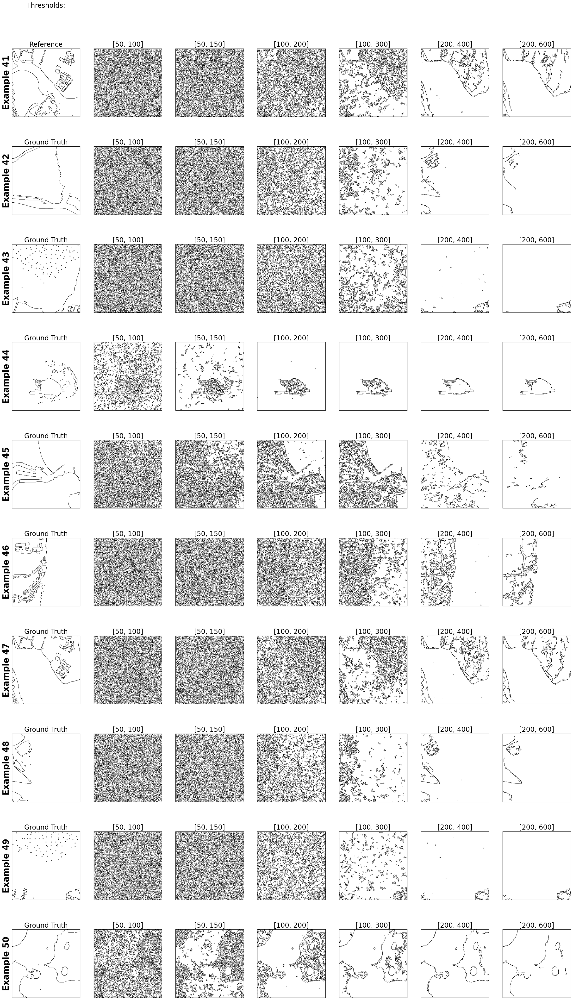

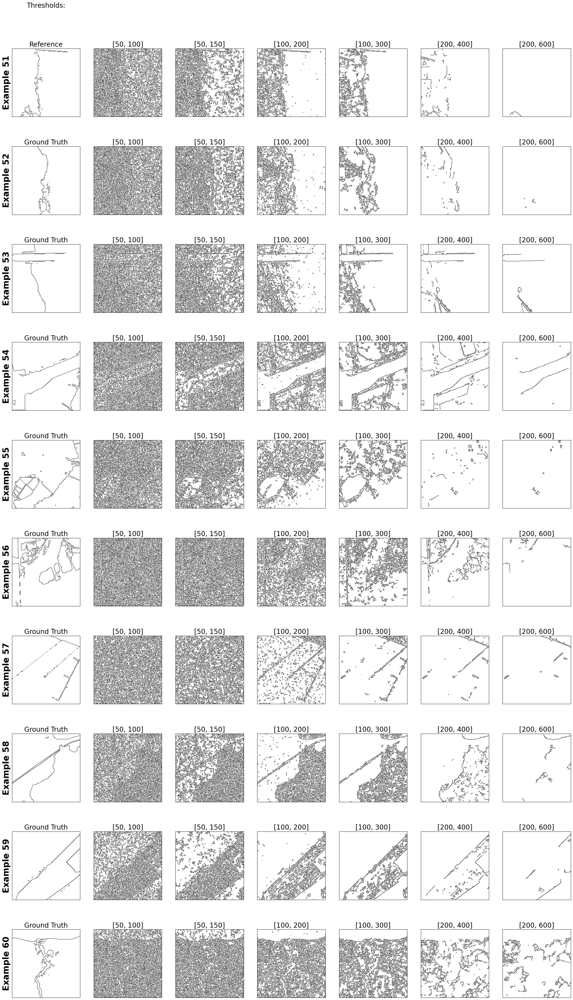

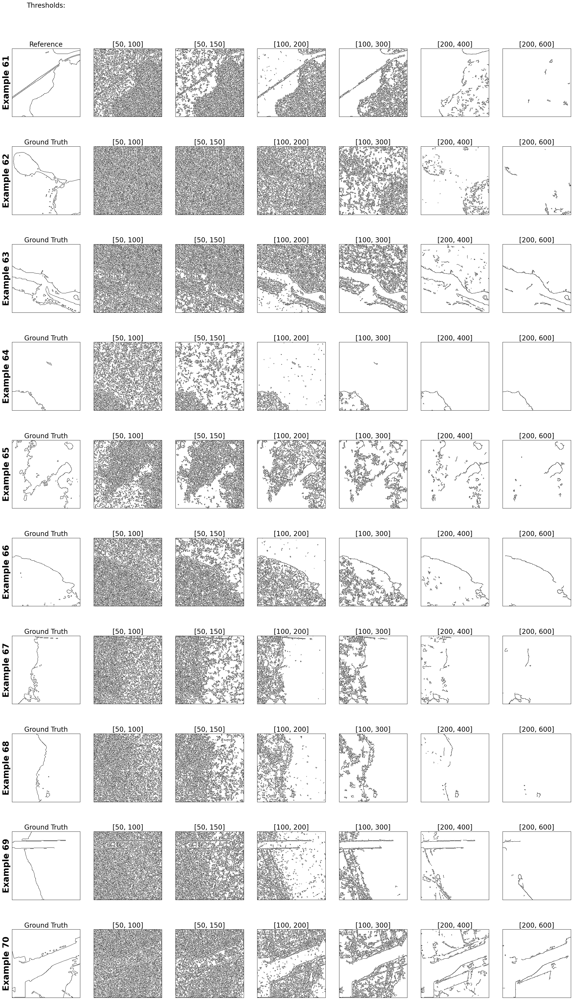

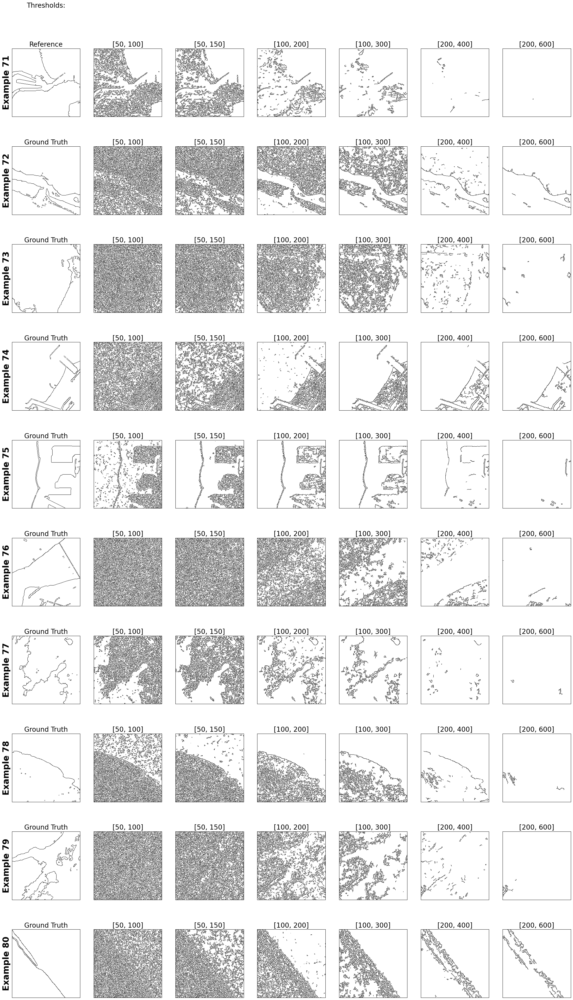

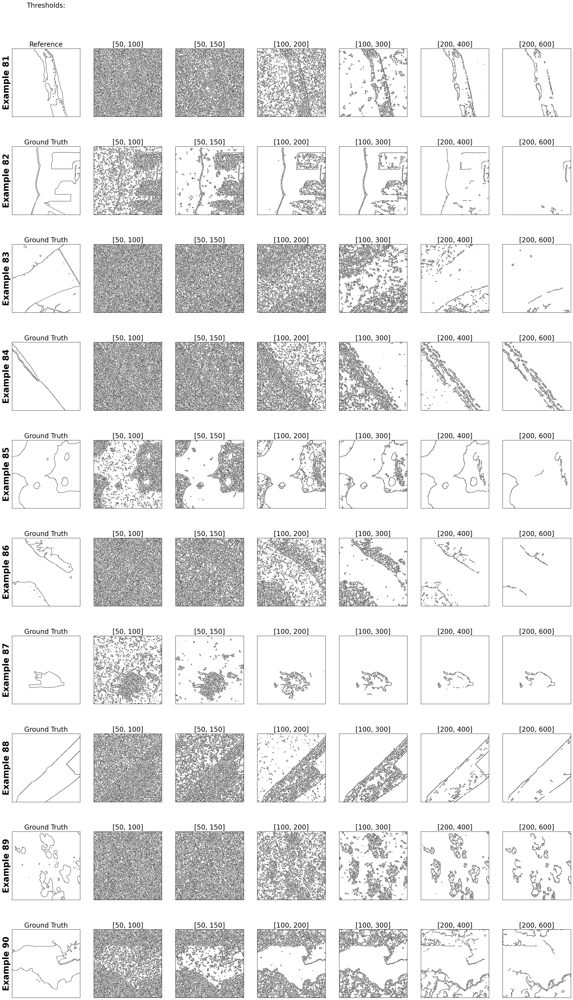

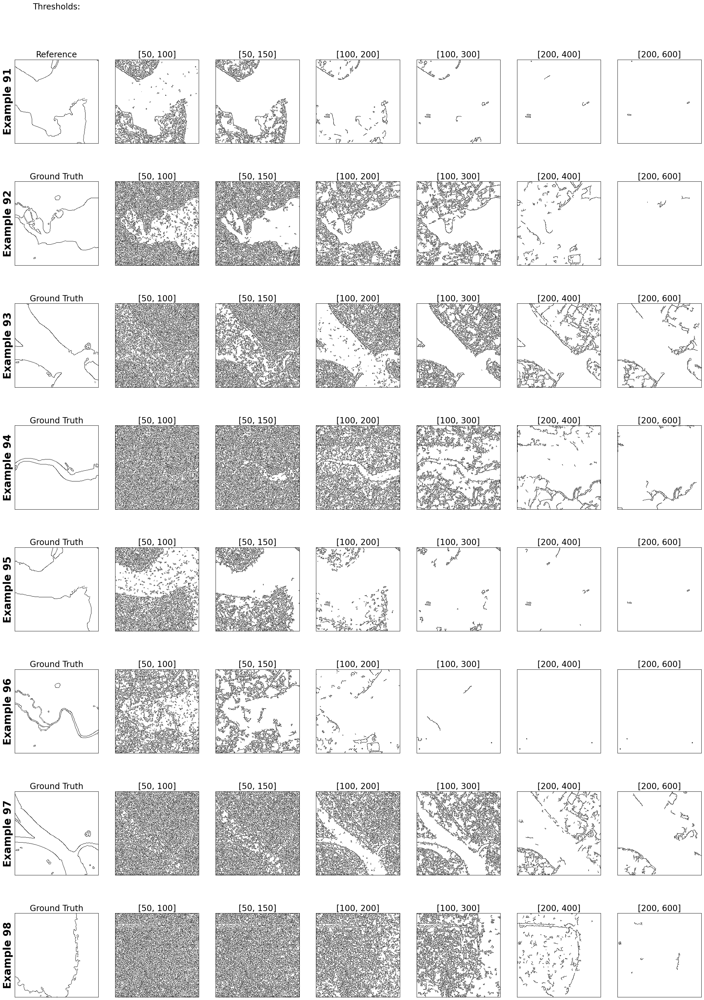

In [59]:
# Visual inspection to choose the best band
# Exclude images 18+1, 41+1, 66+1 from final analysis
ALL_IDS = [range(0,10),range(10,20),range(20,30),range(30,40),range(40,50),range(50,60),range(60,70),range(70,80),range(80,90),range(90,98)]

for i,IDs in enumerate(ALL_IDS):
    viz.example_plots(IDs,ex_diff=10*i,show_metrics=False)

In [60]:
#Imports
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import random

import cv2
import glob
from skimage import feature

from skimage.metrics import structural_similarity as ssim
from sewar.full_ref import rmse, psnr, uqi

# Import helper functions from utils.py
import utils 

#Save path 
save_path = r"E:\SNU Chennai\projects\IVP\edge-detection-metrics\Evaluation metrics"

# Global variables
channels = ['Coastal \nAerosol','Blue','Green',
                 'Red','Red Edge 1','Red Edge 2',
                'Red Edge 3','NIR','Red Edge 4',
                 'Water \nVapour','SWIR 1','SWIR 2']

thresholds = [[50,100],[50,150],[100,200],[100,300],[200,400],[200,600]] 

In [61]:
# Reload utils
import importlib
importlib.reload(utils)

<module 'utils' from 'e:\\SNU Chennai\\projects\\IVP\\edge-detection-metrics\\src\\utils.py'>

In [62]:
test_path = glob.glob(r"E:\SNU Chennai\projects\IVP\edge-detection-metrics\SWED\SWED\test\images\*")
print(test_path[0])
print(len(test_path))

# Initialise data processing class
processor = utils.data_processor()

def get_input(paths):
    # Load all images and labels
    input = []
    rgb = []
    labels = []

    for path in paths:
        try:
            img, rgb_img, label = processor.load_test(path)
        
            input.append(img)
            labels.append(label)
            rgb.append(rgb_img)
        except:
            print("Error with image: ", path)

    # Apply canny edge detection to binary maps to get reference edges
    canny_input = [np.uint8(img*255) for img in labels]
    edge_reference = [np.uint8(cv2.Canny(img,threshold1 = 100, threshold2 = 200)) for img in canny_input]

    return input, rgb, labels, edge_reference

input, rgb, labels, edge_reference = get_input(test_path)


E:\SNU Chennai\projects\IVP\edge-detection-metrics\SWED\SWED\test\images\S2A_MSIL2A_20190312T031541_N0211_R118_T48QYJ_20190312T083550_image_0_0.tif
98


42
0 255


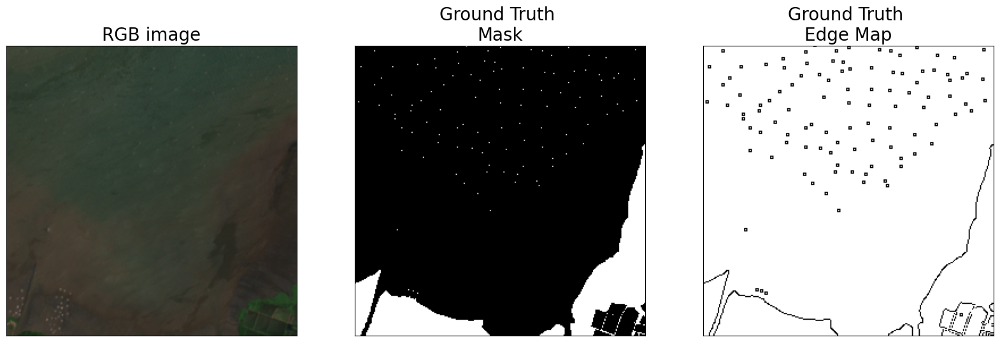

In [63]:
# Sense check edge references
rint = np.random.randint(0,len(edge_reference))
print(rint)
fig, ax = plt.subplots(1,3, figsize=(20,20))
fig.set_facecolor('white')

ax[0].imshow(rgb[rint])
ax[0].set_title('RGB image',size=20)
ax[1].imshow(1-labels[rint] ,  cmap='gray')
ax[1].set_title('Ground Truth \nMask',size=20)
ax[2].imshow(255-edge_reference[rint], cmap='gray')
ax[2].set_title('Ground Truth \nEdge Map',size=20)

for a in ax:
    a.set_xticks([])
    a.set_yticks([])

print(np.min(edge_reference[rint]) ,np.max(edge_reference[rint]))

plt.savefig(save_path + '\\Figures\\dataset_example.png', dpi=300, bbox_inches='tight')

In [64]:
# Apply Canny edge detection with Gaussian blur before edge detection
def get_canny(input):
    canny_input = input.copy()
    canny = {}

    for threshold in thresholds:
        t1 = threshold[0]
        t2 = threshold[1]
        canny_outputs = []

        for img in canny_input:
            blurred_img = img.copy()

            # Apply Gaussian Blur per band
            for i in range(blurred_img.shape[2]):
                blurred_img[:, :, i] = cv2.GaussianBlur(blurred_img[:, :, i], (3, 3), 0)

            # Apply canny edge detection using processor
            edge_img = processor.canny_ed(blurred_img, threshold1=t1, threshold2=t2)
            canny_outputs.append(edge_img)

        canny[str(threshold)] = canny_outputs
        print(threshold, len(canny_outputs), 'done')

    return canny

# Run updated Canny with blur
canny = get_canny(input)


[50, 100] 98 done
[50, 150] 98 done
[100, 200] 98 done
[100, 300] 98 done
[200, 400] 98 done
[200, 600] 98 done


In [65]:
# Evaluate canny edge detection with rmse, psnr, uqi, ssim and fom and confusion matrix measures
rows = []

for threshold in thresholds:
    canny_output = canny[str(threshold)]

    for i, output in enumerate(canny_output):
        ref_img = edge_reference[i]
        #ID = "IMG#{}".format(i)
        ID = i
        for j in range(len(channels)):
                
            img = output[:,:,j]

            # Evaluation metrics
            rmse_ = rmse(ref_img,img)
            psnr_ = psnr(ref_img,img)
            uqi_ = uqi(ref_img,img)
            ssim_ = ssim(ref_img,img,multichannel=True)
            fom_ = processor.fom(ref_img,img)
            tp_,fp_,tn_,fn_,tpr_,fpr_,tnr_,fnr_,fp_fn_ratio_ = processor.get_rates(ref_img,img)

            # detect edges as a percentage of reference edges
            pde_ = np.count_nonzero(img)/np.count_nonzero(ref_img)
            
            row = [ID,tuple(threshold),j+ 1,rmse_,psnr_,uqi_,ssim_,fom_,tp_,fp_,tn_,fn_,tpr_,fpr_,tnr_,fnr_,fp_fn_ratio_,pde_]
            rows.append(row)

    print(threshold,'done')
    
df_metrics = pd.DataFrame(rows,columns = ['ID',"thresholds","band","rmse","psnr","uqi","ssim","fom","tp","fp","tn","fn","tpr","fpr","tnr","fnr","fp_fn_ratio","pde"])
df_metrics.to_csv(save_path+"\\canny_evaluation_metrics.csv")
df_metrics.head()

[50, 100] done
[50, 150] done
[100, 200] done
[100, 300] done
[200, 400] done
[200, 600] done


,ID,thresholds,band,rmse,psnr,uqi,ssim,fom,tp,fp,tn,fn,tpr,fpr,tnr,fnr,fp_fn_ratio,pde
0,0,"(50, 100)",1,58.946536,12.721638,0.681632,0.696542,0.280189,134,1206,61900,2296,0.055144,0.019111,0.980889,0.944856,0.525261,0.551440
1,0,"(50, 100)",2,62.730185,12.181272,0.682763,0.693917,0.488194,382,1918,61188,2048,0.157202,0.030393,0.969607,0.842798,0.936523,0.946502
2,0,"(50, 100)",3,64.161119,11.985365,0.679344,0.689302,0.499920,415,2134,60972,2015,0.170782,0.033816,0.966184,0.829218,1.059057,1.048971
3,0,"(50, 100)",4,67.470188,11.548565,0.662621,0.670847,0.502851,581,2739,60367,1849,0.239095,0.043403,0.956597,0.760905,1.481341,1.366255
4,0,"(50, 100)",5,63.061467,12.135522,0.688431,0.696728,0.552205,579,2157,60949,1851,0.238272,0.034181,0.965819,0.761728,1.165316,1.125926


In [66]:
df_metrics = pd.read_csv(save_path+"\\canny_evaluation_metrics.csv")
df_metrics['fp_fn'] = df_metrics['fp'] + df_metrics['fn']

# Initialise visualisation class
viz = utils.data_visualizer(df_metrics,canny,edge_reference,rgb,thresholds,channels)

In [67]:
df_metrics.head()

,Unnamed: 0,ID,thresholds,band,rmse,psnr,uqi,ssim,fom,tp,fp,tn,fn,tpr,fpr,tnr,fnr,fp_fn_ratio,pde,fp_fn
0,0,0,"(50, 100)",1,58.946536,12.721638,0.681632,0.696542,0.280189,134,1206,61900,2296,0.055144,0.019111,0.980889,0.944856,0.525261,0.551440,3502
1,1,0,"(50, 100)",2,62.730185,12.181272,0.682763,0.693917,0.488194,382,1918,61188,2048,0.157202,0.030393,0.969607,0.842798,0.936523,0.946502,3966
2,2,0,"(50, 100)",3,64.161119,11.985365,0.679344,0.689302,0.499920,415,2134,60972,2015,0.170782,0.033816,0.966184,0.829218,1.059057,1.048971,4149
3,3,0,"(50, 100)",4,67.470188,11.548565,0.662621,0.670847,0.502851,581,2739,60367,1849,0.239095,0.043403,0.956597,0.760905,1.481341,1.366255,4588
4,4,0,"(50, 100)",5,63.061467,12.135522,0.688431,0.696728,0.552205,579,2157,60949,1851,0.238272,0.034181,0.965819,0.761728,1.165316,1.125926,4008


In [68]:
#Update visualisation class 
# The following test images are removed due to labelling errors: 18, 41, 66
df_metrics_2 = df_metrics.copy()
df_metrics_2 = df_metrics_2.drop(df_metrics_2[df_metrics_2['ID'] == 18].index)
df_metrics_2 = df_metrics_2.drop(df_metrics_2[df_metrics_2['ID'] == 41].index)
df_metrics_2 = df_metrics_2.drop(df_metrics_2[df_metrics_2['ID'] == 66].index)

df_metrics_2['fp_fn'] = df_metrics_2['fp'] + df_metrics_2['fn']


test_paths_2 = test_path.copy()
path1 = test_paths_2.pop(18)
path2 = test_paths_2.pop(41-1)
path3 = test_paths_2.pop(66-2)
print(path1)
print(path2)
print(path3)

input_2, rgb_2, labels_2, edge_reference_2 = get_input(test_paths_2)

canny_2 = get_canny(input_2)

viz_2 = utils.data_visualizer(df_metrics_2,canny_2,edge_reference_2,rgb_2,thresholds,channels)


E:\SNU Chennai\projects\IVP\edge-detection-metrics\SWED\SWED\test\images\S2A_MSIL2A_20190725T072621_N0213_R049_T37MER_20190725T114710_image_0_0.tif
E:\SNU Chennai\projects\IVP\edge-detection-metrics\SWED\SWED\test\images\S2A_MSIL2A_20191003T022551_N0213_R046_T49MGM_20191003T062924_image_0_3.tif
E:\SNU Chennai\projects\IVP\edge-detection-metrics\SWED\SWED\test\images\S2A_MSIL2A_20191226T071311_N0213_R106_T39RWH_20191226T094655_image_0_1.tif
[50, 100] 95 done
[50, 150] 95 done
[100, 200] 95 done
[100, 300] 95 done
[200, 400] 95 done
[200, 600] 95 done


In [69]:
print("fp_fn" in df_metrics_2.columns)
print(df_metrics_2[["fp", "fn", "fp_fn"]].head())


True
     fp    fn  fp_fn
0  1206  2296   3502
1  1918  2048   3966
2  2134  2015   4149
3  2739  1849   4588
4  2157  1851   4008


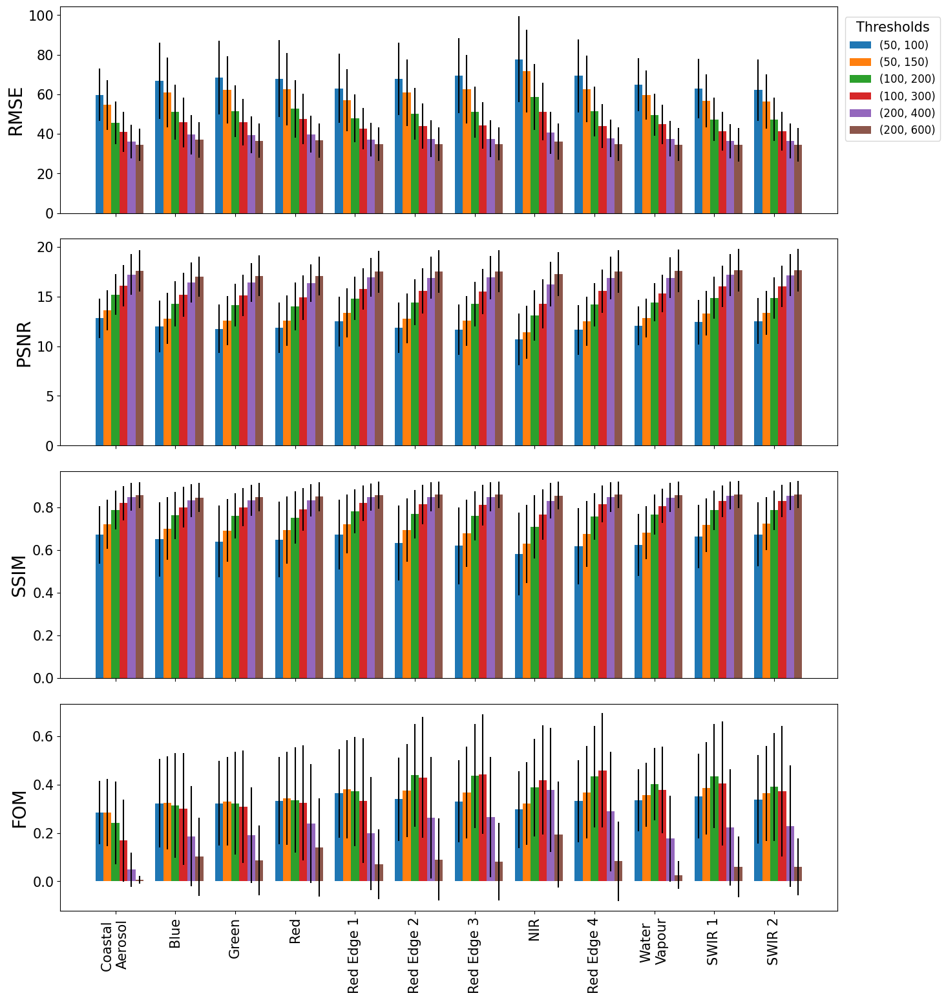

In [70]:
viz_2.plot_combined_metric_trends(['rmse','psnr','ssim','fom'],save_path=save_path+"\\Figures\\all_metrics.png")

In [71]:
# NIR table 
df_metrics_nir = df_metrics_2[df_metrics_2['band']==7]

df_mean = df_metrics_nir[['thresholds', 'rmse','psnr','ssim','fom']].groupby('thresholds').mean().reset_index()
df_mean['threshold 1'] = df_mean['thresholds'].apply(lambda x: int(x.split(',')[0][1:]))
df_mean['threshold 2'] = df_mean['thresholds'].apply(lambda x: int(x.split(',')[1][:-1]))

df_mean = df_mean.sort_values(by=['threshold 1','threshold 2'])[['threshold 1','threshold 2','rmse','psnr','ssim','fom']]
df_mean.columns = ['Threshold 1','Threshold 2','RMSE','PSNR','SSIM','FOM']
df_mean = df_mean.round(2)

df_mean.to_clipboard(index=False)

df_mean.head()

,Threshold 1,Threshold 2,RMSE,PSNR,SSIM,FOM
4,50,100,69.35,11.66,0.62,0.33
5,50,150,62.60,12.55,0.68,0.37
0,100,200,51.04,14.26,0.76,0.44
1,100,300,44.28,15.50,0.81,0.44
2,200,400,37.52,16.91,0.85,0.27


In [72]:
# counts of best thresholds
best_threshold_count = pd.DataFrame(thresholds,columns=['threshold1','threshold2'])

for metric in ['rmse','psnr','ssim','fom']:

    df = df_metrics_2[['ID','thresholds',metric]]

    if metric == 'rmse':
        best_thresholds = df.loc[df.groupby('ID')[metric].idxmin()]
    else:
        best_thresholds = df.loc[df.groupby('ID')[metric].idxmax()]
    count = []
    print(f"\nBest thresholds for {metric}:")
    print(best_thresholds.head())  # Debugging
    for threshold in thresholds:
        df = best_thresholds[best_thresholds['thresholds'].astype(str) == str(tuple(threshold))]
        count.append(len(df))
        # Debugging: Print how many times each threshold appears
        print(f"Threshold {threshold}: {len(df)} occurrences")

    best_threshold_count[metric] = count

best_threshold_count.columns = ['Threshold 1','Threshold 2','RMSE','PSNR','SSIM','FOM']

best_threshold_count.to_clipboard(index=False)
best_threshold_count


Best thresholds for rmse:
      ID  thresholds       rmse
5880   0  (200, 600)  49.102471
5892   1  (200, 600)  33.006645
5904   2  (200, 600)  34.976935
5920   3  (200, 600)  33.186519
5937   4  (200, 600)  43.040011
Threshold [50, 100]: 0 occurrences
Threshold [50, 150]: 0 occurrences
Threshold [100, 200]: 2 occurrences
Threshold [100, 300]: 0 occurrences
Threshold [200, 400]: 15 occurrences
Threshold [200, 600]: 78 occurrences

Best thresholds for psnr:
      ID  thresholds       psnr
5880   0  (200, 600)  14.308737
5892   1  (200, 600)  17.758776
5904   2  (200, 600)  17.255169
5920   3  (200, 600)  17.711570
5937   4  (200, 600)  15.453356
Threshold [50, 100]: 0 occurrences
Threshold [50, 150]: 0 occurrences
Threshold [100, 200]: 2 occurrences
Threshold [100, 300]: 0 occurrences
Threshold [200, 400]: 15 occurrences
Threshold [200, 600]: 78 occurrences

Best thresholds for ssim:
      ID  thresholds      ssim
4711   0  (200, 400)  0.765259
5892   1  (200, 600)  0.874369
5904   2  

,Threshold 1,Threshold 2,RMSE,PSNR,SSIM,FOM
0,50,100,0,0,3,4
1,50,150,0,0,1,8
2,100,200,2,2,2,14
3,100,300,0,0,11,49
4,200,400,15,15,37,18
5,200,600,78,78,41,2


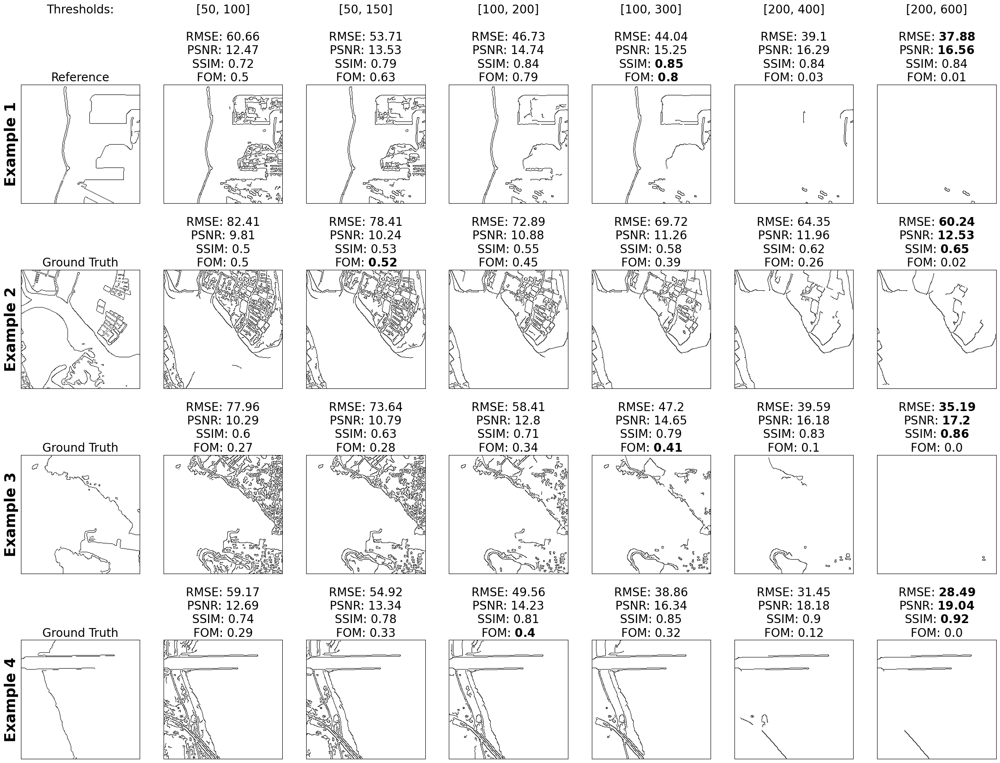

In [73]:
# Examples of results where FOM identifies the best threshold
import ast

# Convert thresholds to tuples if they are stored as strings
df_metrics_2["thresholds"] = df_metrics_2["thresholds"].apply(lambda x: tuple(ast.literal_eval(x)) if isinstance(x, str) else x)

IDs = [74,40,2,68]
viz.example_plots(IDs,save_path=save_path+"\\Figures\\good_examples.png")

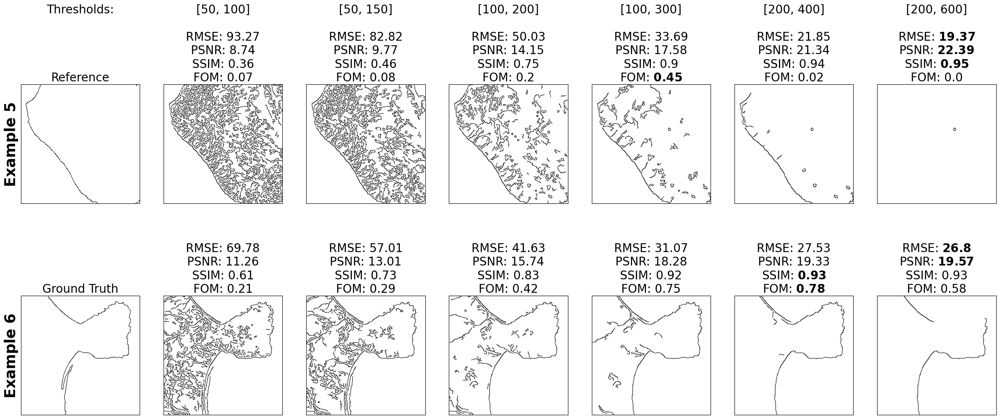

In [74]:
# Examples of results where FOM does not identify the best threshold
IDs = [15,32]
viz.example_plots(IDs,ex_diff=4,save_path=save_path+"\\Figures\\bad_examples.png")

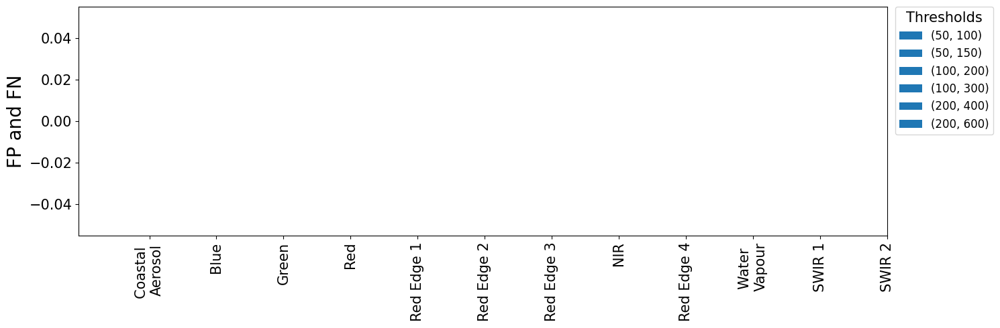

In [75]:
viz_2.plot_metric_trends('fp_fn', ylabel="FP and FN", save_path=save_path+"\\Figures\\fp_fn_sum.png")


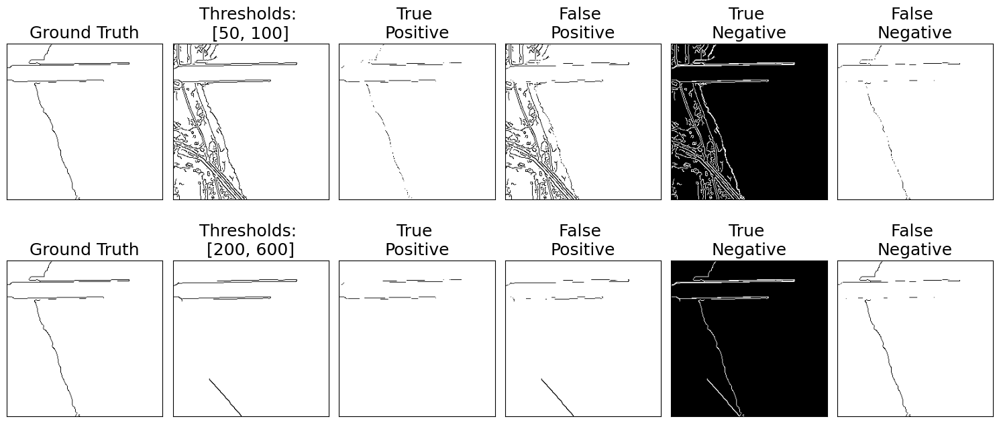

In [76]:
# Plot of confusion matrix metrics for different thresholds
rint = random.randint(0,len(edge_reference))
rint = 68 
band = 7 
threshold = [100,300]

fig, axs = plt.subplots(2,6, figsize=(15,7))
fig.set_facecolor('white')

for i, threshold in enumerate([[50,100],[200,600]]):
    reference = edge_reference[rint]*1.0
    reference = np.array(reference)

    detected =  canny[str(threshold)][rint][:,:,band]*1.0
    detected = np.array(detected)

    # True Positive
    TP = reference - (255-detected)
    TP[TP<0] = 0

    # False Positive
    FP = detected - TP

    # False negatives
    N = 255 - detected
    FN = N - (255-reference)

    # True Negative
    TN  = (255-reference) -detected
    TN[TN<0] = 0

    # False Negative
    FN = (255-detected) - (255-reference)
    FN[FN<0] = 0

    axs[i,0].imshow(255-reference,cmap="gray")
    axs[i,0].set_title("Ground Truth",size=18)

    axs[i,1].imshow(255-detected,cmap="gray")
    axs[i,1].set_title("Thresholds: \n{}".format(threshold),size=18)

    axs[i,2].imshow(255-TP,cmap="gray")
    axs[i,2].set_title("True \nPositive",size=18)

    axs[i,3].imshow(255-FP,cmap="gray")
    axs[i,3].set_title("False \nPositive",size=18)

    axs[i,4].imshow(255-TN,cmap="gray")
    axs[i,4].set_title("True \nNegative",size=18)

    axs[i,5].imshow(255-FN,cmap="gray")
    axs[i,5].set_title("False \nNegative",size=18)

for ax in axs.flat:
    ax.set_xticks([])
    ax.set_yticks([])

plt.tight_layout()
plt.savefig(save_path+"\\Figures\\TP_FP_example.png",dpi=300)

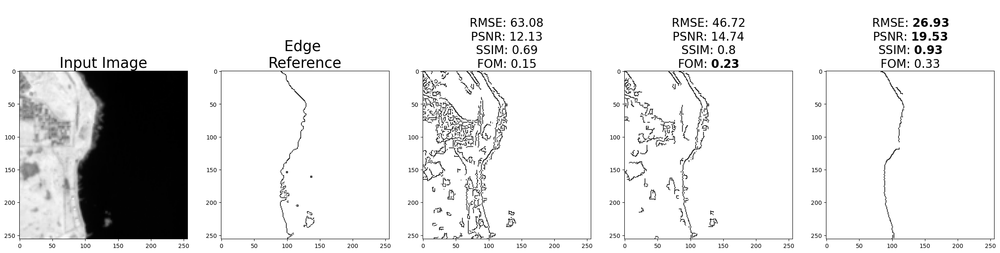

In [77]:
import importlib
importlib.reload(utils)  # Ensure latest version of utils is used

fig, axs = plt.subplots(1, 5, figsize=(30, 20))
fig.set_facecolor('white')

rint = 67  # Select image index

thresholds = [[50,100],[100,200],[200,400]]
band = 10 

img_input = input[rint].copy()

axs[0].imshow(img_input[:,:,band], cmap="gray")
axs[0].set_title("Input Image", size=25)

ref_img = edge_reference[rint]
axs[1].imshow(255 - ref_img, cmap="gray")
axs[1].set_title("Edge \nReference", size=25)

# Ensure we use the processor instance to call canny_ed
processor = utils.data_processor()  

for i, threshold in enumerate(thresholds):
    t1, t2 = threshold
    canny = processor.canny_ed(img_input, threshold1=t1, threshold2=t2)  # Call with processor instance
    img = canny[:,:,band]
    
    axs[i+2].imshow(255 - img, cmap="gray")
    
    rmse_ = round(rmse(ref_img, img), 2)
    psnr_ = round(psnr(ref_img, img), 2)
    ssim_ = round(ssim(ref_img, img, multichannel=True), 2)
    fom_ = round(processor.fom(ref_img, img), 2)

    if i == 0:
        axs[i+2].set_title("\nRMSE: {}\nPSNR: {}\nSSIM: {}\nFOM: {}".format(rmse_, psnr_, ssim_, fom_), size=20)
    elif i == 1:
        axs[i+2].set_title("\nRMSE: {}\nPSNR: {}\nSSIM: {}\nFOM: ".format(rmse_, psnr_, ssim_) + r"$\bf{" + str(fom_) + "}$", size=20)
    else:
        axs[i+2].set_title("\nRMSE: " + r"$\bf{" + str(rmse_) + "}$" + 
                           "\nPSNR: " + r"$\bf{" + str(psnr_) + "}$" +
                           "\nSSIM: " + r"$\bf{" + str(ssim_) + "}$" +
                           "\nFOM: " + str(fom_), size=20)

plt.show()


In [78]:
#Get image names for visual analysis
x = [path.split("/")[-1] for path in test_path]
df = pd.DataFrame({"ID":x})
df.to_clipboard(index=False)

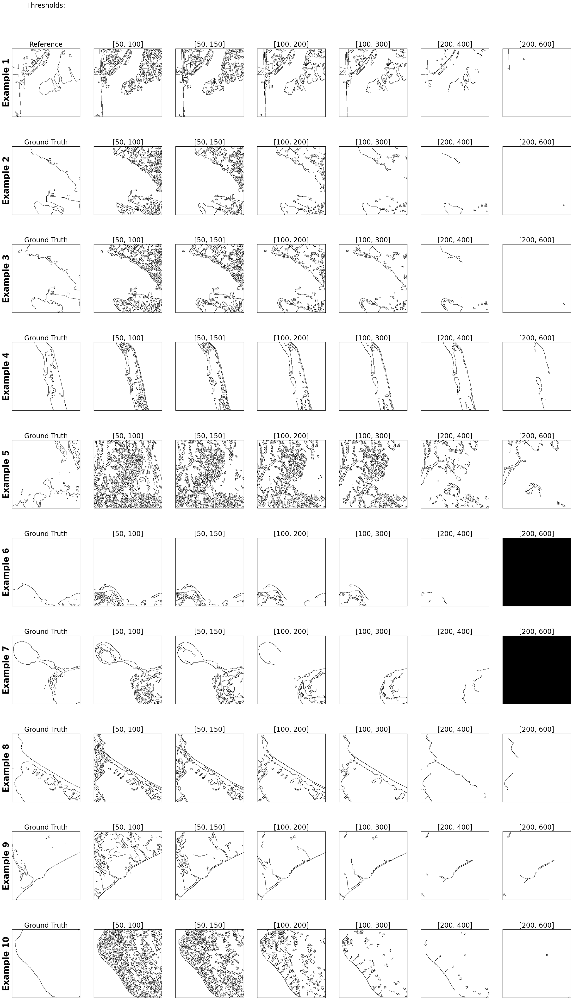

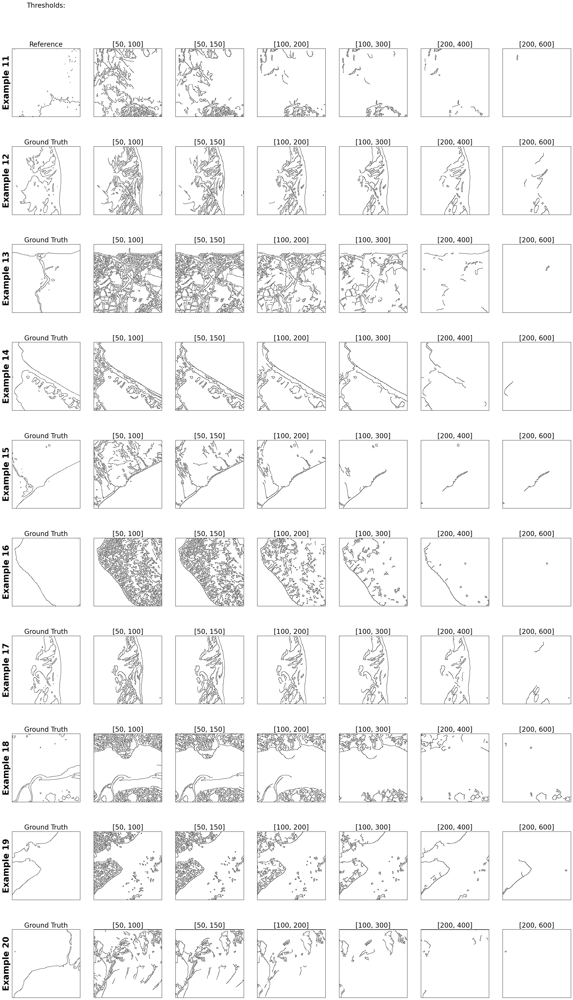

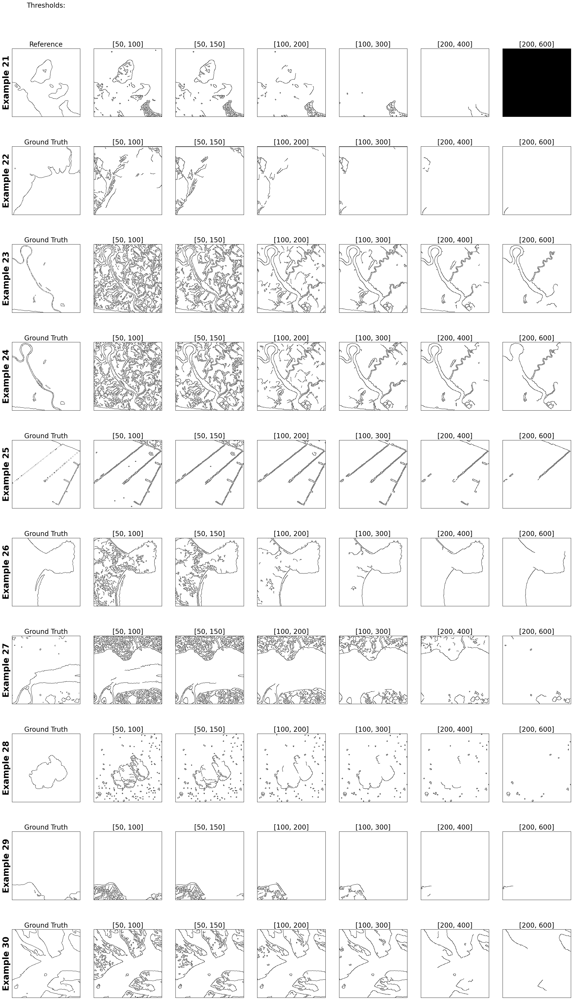

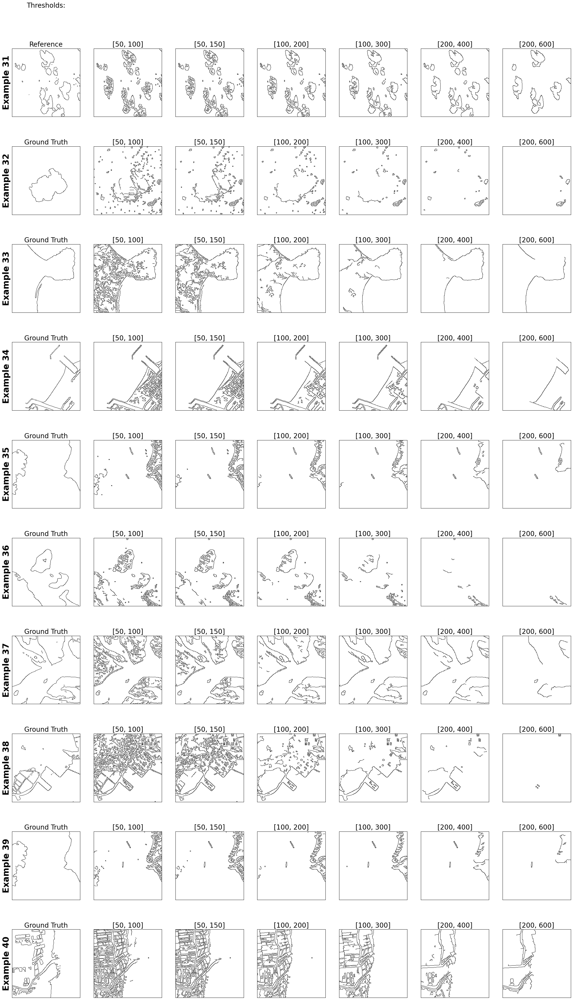

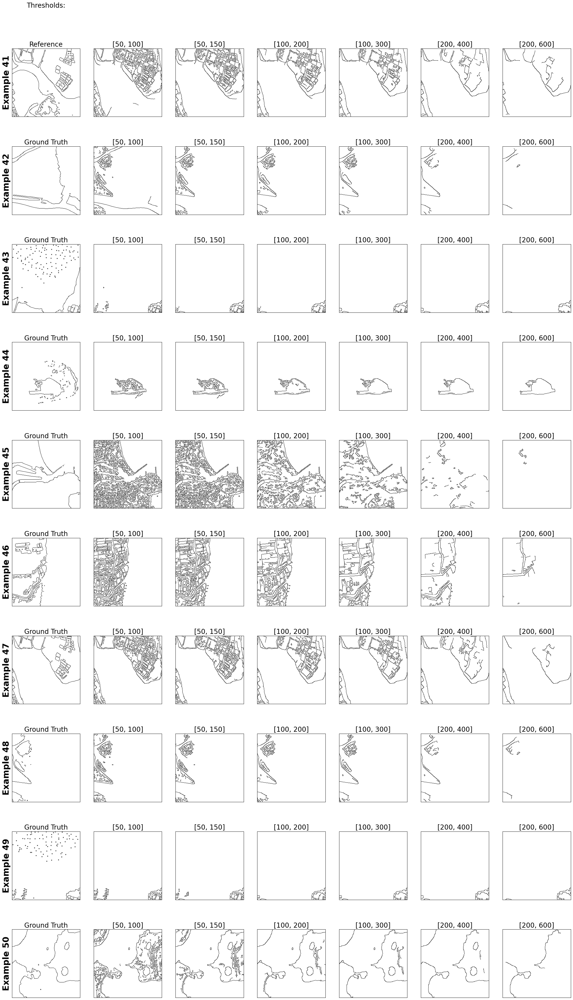

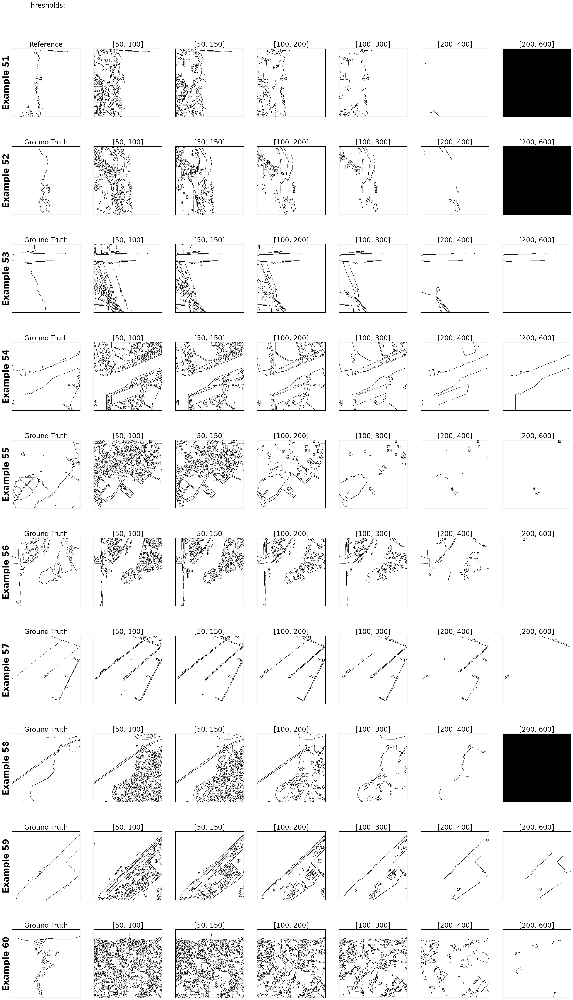

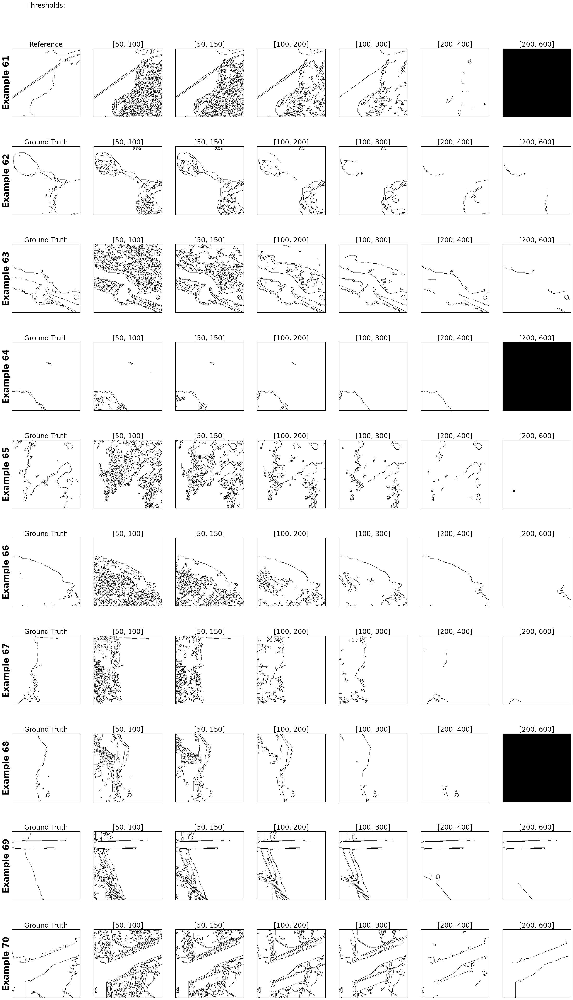

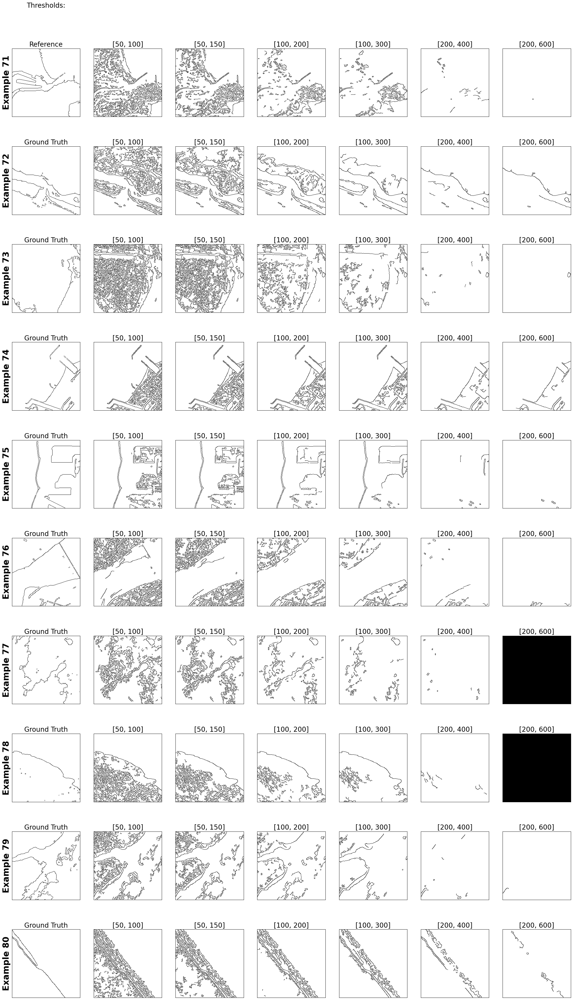

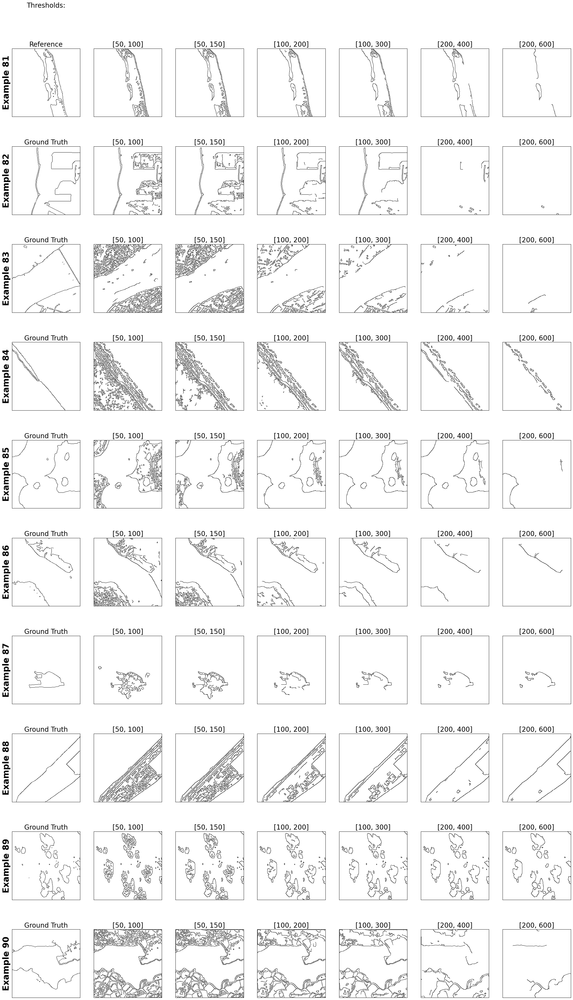

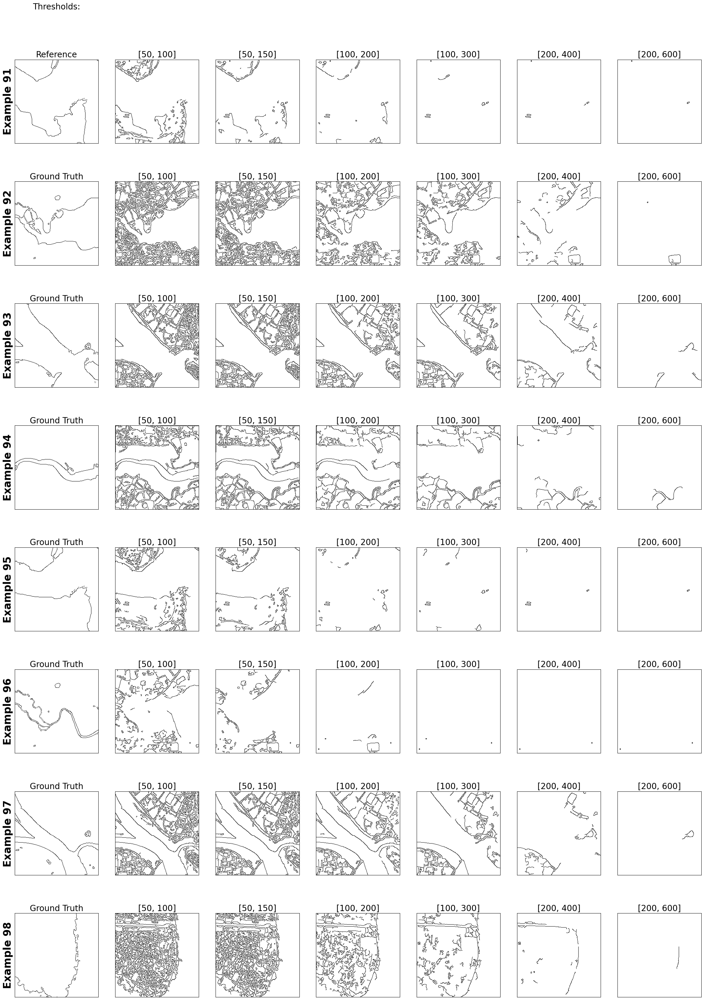

In [79]:
# Visual inspection to choose the best band
# Exclude images 18+1, 41+1, 66+1 from final analysis
ALL_IDS = [range(0,10),range(10,20),range(20,30),range(30,40),range(40,50),range(50,60),range(60,70),range(70,80),range(80,90),range(90,98)]

for i,IDs in enumerate(ALL_IDS):
    viz.example_plots(IDs,ex_diff=10*i,show_metrics=False)